In [1]:
import pandas as pd
#from hmmlearn import hmm
import numpy as np
import seaborn as sns
from scipy.stats import norm
import itertools
import matplotlib.pyplot as plt
#from hmmlearn.hmm import GMMHMM
from  sklearn.metrics import mean_squared_error as mse
from astropy.io import fits
import matplotlib.pyplot as plt
import os, sys

def plot_state_matrix(cm, states,title='Transition Probabilities',cmap=plt.cm.Blues):
    plt.figure(figsize=(10,10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(states))
    plt.xticks(tick_marks, states)
    plt.yticks(tick_marks, states)
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], '.1f'),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > cm.max() / 2. else "black")
    plt.ylabel('Origin state')
    plt.xlabel('Destination state')
    plt.tight_layout()


dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC
folder = "/work/work_teamEXOPLANET/KOI_LC/"

time_kepler = np.load(folder+"npy/KOI_LC_time.npy") 
our_process = np.load('/work/work_teamEXOPLANET/KOI_LC/cleaned/LC_kepler_processed.npy')
our_process.shape 

(8054, 71427)

In [2]:
df= pd.read_csv(folder+"csv/kepler_dataset.csv")

df_meta=pd.read_csv('../../KOI_Data/kepler_dataset.csv')
kplr_ids=np.asarray(df['Kepler ID'].values)[[index_fp]]

In [3]:
#### importante:
def prepare_lc_GAF(fluxs): #rango entre -1 y 1
    fluxs = np.asarray(fluxs)
    max_f = np.nanmax(fluxs)
    min_f = np.nanmin(fluxs)
    return (2*fluxs- max_f - min_f)/(max_f-min_f)
    #return MinMaxScaler(feature_range=(-1, 1)).fit_transform(fluxs)

def extract_nans(fluxs):
    ###extrae los nans y deja tramos de valores continuos
    lc_wind_nan = []
    lengths = []

    sublist = []
    for value in fluxs:
        if np.isnan(value) and len(sublist) != 0:
            if len(sublist) != 1: ##borrar tramos de largo 1??
                lc_wind_nan.append(np.asarray(sublist))
                lengths.append(len(sublist))
            sublist = []
        elif np.isnan(value) and len(sublist) == 0:
            continue
        else: #if value not nan
            sublist.append(value) 
    lc_wind_nan = np.asarray(lc_wind_nan)   
    lengths = np.asarray(lengths)   

    print("Cantidad de tramos: ",len(lengths))
    print("Largo promedio de tramos: ", np.mean(lengths))
    print("Mediana de largo de tramos: ", np.median(lengths))
    print("Min de largo de tramos: ", np.min(lengths))
    print("Max de largo de tramos: ", np.max(lengths))
    return lc_wind_nan

In [11]:
%%time
fluxs = our_process[0]
fluxs = prepare_lc_GAF(fluxs) #scale -1 y 1 o hacerlo pro tramo?

fluxs = np.nan_to_num(fluxs) #nans a 0

CPU times: user 3.24 ms, sys: 1.06 ms, total: 4.3 ms
Wall time: 3.01 ms


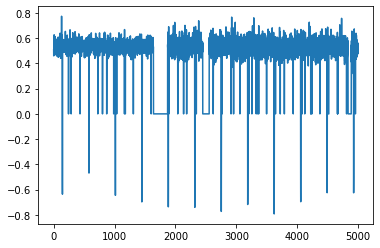

In [12]:
plt.plot(fluxs[:5000])

In [23]:
from pyts.image import GramianAngularField
from pyts.datasets import load_gunpoint

# Parameters
X, _, _, _ = load_gunpoint(return_X_y=True)

# Transform the time series into Gramian Angular Fields
gasf = GramianAngularField(image_size=24, method='summation')
X_gasf = gasf.fit_transform(X)

ModuleNotFoundError: No module named 'pyts'

In [4]:
## con numpy

#@njit() #demora menos??
def calculate_GAF(fluxs, method='sum'):
    X_cos = np.asarray(fluxs).astype('float32')
    I = np.ones(X_cos.shape[0], dtype='float32')
    
    X_sin =  np.sqrt(np.clip(I-X_cos**2, 0, 1))
    if method == 'sum':
        return  np.tensordot(X_cos, X_cos, axes=-1) - np.tensordot(X_sin, X_sin, axes=-1)
    elif method == "diff":
        return  np.tensordot(X_sin, X_cos, axes=-1) - np.tensordot(X_cos, X_sin, axes=-1)

Cantidad de tramos:  796
Largo promedio de tramos:  80.82663316582915
Mediana de largo de tramos:  79.0
Min de largo de tramos:  2
Max de largo de tramos:  149


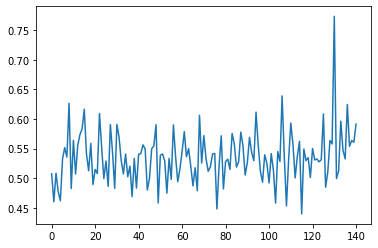

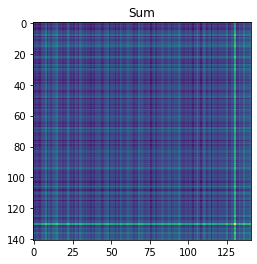

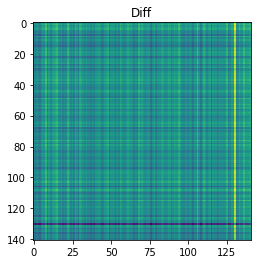

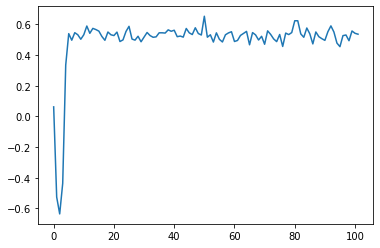

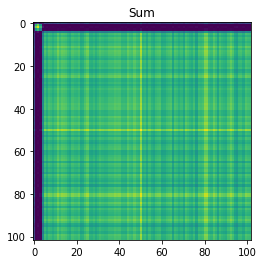

...

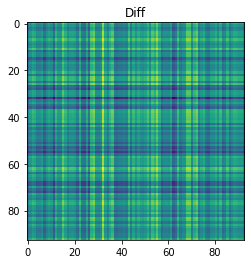

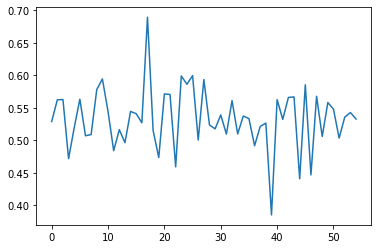

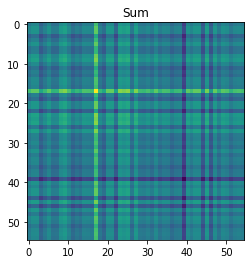

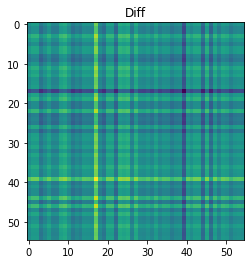

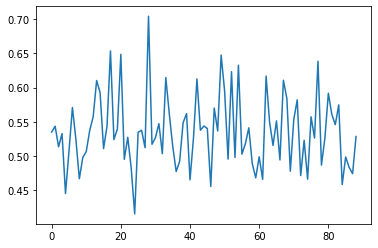

In [ ]:
i = 0
fluxs = our_process[i]

fluxs = prepare_lc_GAF(fluxs) #scale -1 y 1 o hacerlo pro tramo?
lc_tramos =  extract_nans(fluxs) #extract nans

for tramo in lc_tramos:
    plt.plot(tramo)
    plt.show()
    X_gaf = calculate_GAF(tramo, method='sum')
    plt.imshow(X_gaf)
    plt.title("Sum")
    plt.show()
    X_gaf = calculate_GAF(tramo, method='diff')
    plt.imshow(X_gaf)
    plt.title("Diff")
    plt.show()

[]

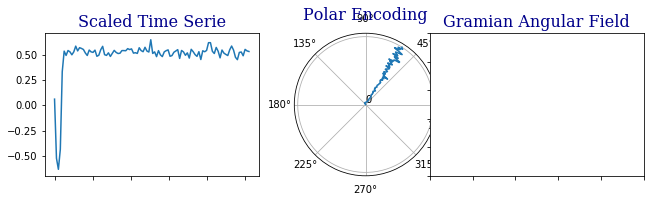

In [108]:
import math

def gramian_angular_field(scaled_serie):
    """Compute the Gramian Angular Field of an image"""
    # Min-Max scaling
    #min_ = np.amin(serie)
    #max_ = np.amax(serie)
    #scaled_serie = (2*serie - max_ - min_)/(max_ - min_)

    # Floating point inaccuracy!
    #scaled_serie = np.where(scaled_serie >= 1., 1., scaled_serie)
    #scaled_serie = np.where(scaled_serie <= -1., -1., scaled_serie)

    # Polar encoding
    phi = np.arccos(scaled_serie)
    # Note! The computation of r is not necessary
    r = np.linspace(0, 1, len(scaled_serie))

    return(phi, r, scaled_serie)

t, time_serie = np.arange(0,lc_tramos[1].shape[0]*0.0253, 0.0253), lc_tramos[1]
    
phi, r, scaled_time_serie = gramian_angular_field(time_serie)

# Set to 0 unkown data at time stamp iteration
#t[iteration:] = 0
#time_serie[:] = 0
#scaled_time_serie[:] = 0
#phi[:] = math.acos(0)
#r[iteration:] = 0

# Instanciate figure
fig = plt.figure(figsize=(9, 6))
size = 0.33
alignement = 0.1
# Classic plot
ax_carthesian = fig.add_axes([alignement, 0.4, size, size])
# Polar plot
ax_polar = fig.add_axes([alignement + size, 0.4, size, size], polar=True)
# Patchwork
ax_patchwork = fig.add_axes([alignement + 1.8*size, 0.4, size, size])

# PLOTS
font = {
    'family': 'serif',
    'color':  'darkblue',
    'weight': 'normal',
    'size': 16,
    }

# Clear plot
ax_carthesian.clear()
ax_polar.clear()
ax_patchwork.clear()

# Original Time series
ax_carthesian.plot(t, scaled_time_serie)
ax_carthesian.set_title("Scaled Time Serie", fontdict=font)
ax_carthesian.set_xticklabels([])

# Polar encoding
ax_polar.plot(phi, r)
ax_polar.set_title("Polar Encoding", fontdict=font)
ax_polar.set_rticks([0, 1])
ax_polar.set_rlabel_position(-22.5)
ax_polar.grid(True)

# Gramian Angular Field
ax_patchwork.set_title("Gramian Angular Field", fontdict=font)
ax_patchwork.set_yticklabels([])
ax_patchwork.set_xticklabels([])

### Comportamiento Falsos postiviso

In [5]:
falsos_pos=df.loc[df['NExScI Disposition']=='FALSE POSITIVE']
index_fp=list(falsos_pos.index)
len(index_fp)

our_detrends=our_process[index_fp]
our_detrends.shape

(3976, 71427)

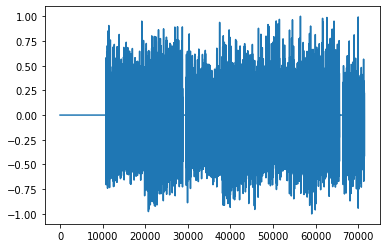

float32
float32


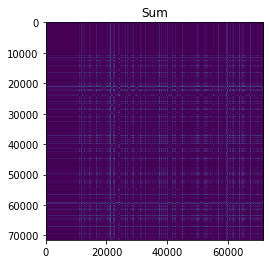

float32
float32


MemoryError: 

In [6]:
i = 0

fluxs = our_detrends[i]

fluxs = prepare_lc_GAF(fluxs) #scale -1 y 1 o hacerlo pro tramo?

mask_nans = np.isnan(fluxs)
fluxs = np.nan_to_num(fluxs) #nans a 0

plt.plot(fluxs)
plt.show()
X_gaf = calculate_GAF(fluxs, method='sum')
plt.imshow(X_gaf)
plt.title("Sum")
plt.show()
X_gaf = calculate_GAF(fluxs, method='diff')
plt.imshow(X_gaf)
plt.title("Diff")
plt.show()

In [10]:
mask_nans = np.isnan(fluxs)

In [ ]:
X_gaf[mask_nans,:] = 0
X_gaf[:,mask_nans] = 0
plt.imshow(X_gaf)
plt.title("Sum")
plt.show()

recuperando curva 1
Cantidad de tramos:  707
Largo promedio de tramos:  77.06506364922207
Mediana de largo de tramos:  72.0
Min de largo de tramos:  2
Max de largo de tramos:  146


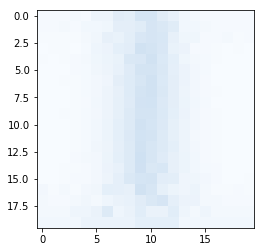

recuperando curva 2
Cantidad de tramos:  803
Largo promedio de tramos:  79.91158156911581
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


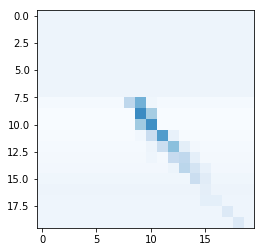

recuperando curva 3
Cantidad de tramos:  788
Largo promedio de tramos:  81.66116751269035
Mediana de largo de tramos:  84.0
Min de largo de tramos:  2
Max de largo de tramos:  146


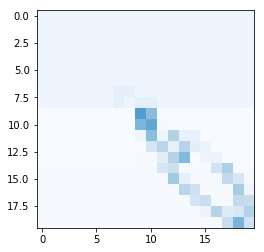

recuperando curva 4
Cantidad de tramos:  806
Largo promedio de tramos:  79.8089330024814
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


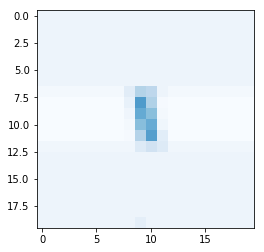

recuperando curva 5
Cantidad de tramos:  807
Largo promedio de tramos:  79.71623296158612
Mediana de largo de tramos:  79.0
Min de largo de tramos:  2
Max de largo de tramos:  149


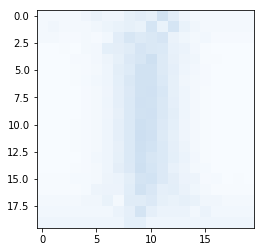

recuperando curva 6
Cantidad de tramos:  772
Largo promedio de tramos:  81.25388601036269
Mediana de largo de tramos:  84.0
Min de largo de tramos:  2
Max de largo de tramos:  146


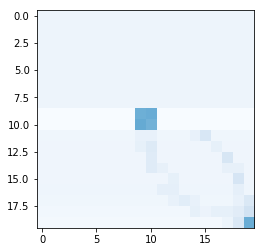

recuperando curva 7
Cantidad de tramos:  801
Largo promedio de tramos:  80.31710362047441
Mediana de largo de tramos:  80.0
Min de largo de tramos:  2
Max de largo de tramos:  149


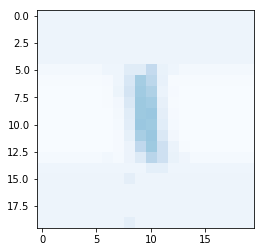

recuperando curva 8
Cantidad de tramos:  467
Largo promedio de tramos:  63.19700214132762
Mediana de largo de tramos:  36.0
Min de largo de tramos:  2
Max de largo de tramos:  145


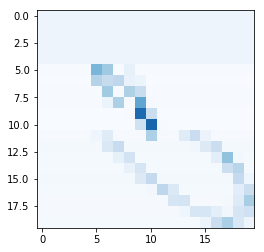

recuperando curva 9
Cantidad de tramos:  254
Largo promedio de tramos:  89.71259842519684
Mediana de largo de tramos:  97.0
Min de largo de tramos:  2
Max de largo de tramos:  146


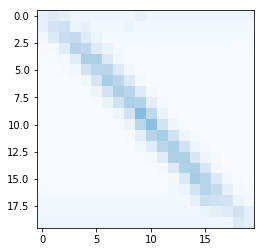

recuperando curva 10
Cantidad de tramos:  807
Largo promedio de tramos:  79.70260223048327
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


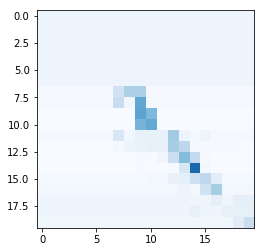

recuperando curva 11
Cantidad de tramos:  107
Largo promedio de tramos:  80.53271028037383
Mediana de largo de tramos:  76.0
Min de largo de tramos:  2
Max de largo de tramos:  145


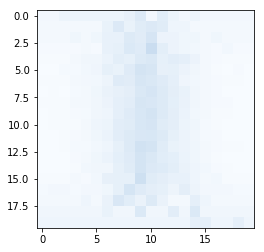

recuperando curva 12
Cantidad de tramos:  654
Largo promedio de tramos:  83.39908256880734
Mediana de largo de tramos:  90.0
Min de largo de tramos:  2
Max de largo de tramos:  149


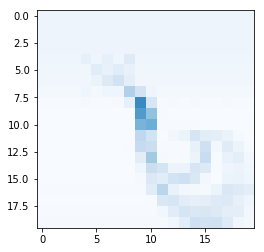

recuperando curva 13
Cantidad de tramos:  929
Largo promedio de tramos:  64.84391819160388
Mediana de largo de tramos:  54.0
Min de largo de tramos:  2
Max de largo de tramos:  146


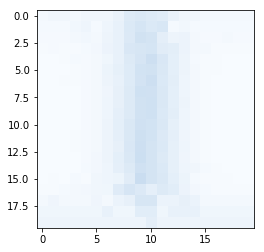

recuperando curva 14
Cantidad de tramos:  812
Largo promedio de tramos:  79.20689655172414
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  146


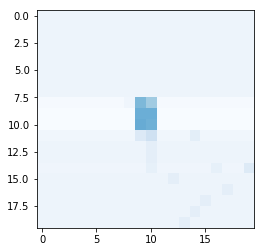

recuperando curva 15
Cantidad de tramos:  836
Largo promedio de tramos:  76.91866028708134
Mediana de largo de tramos:  73.0
Min de largo de tramos:  2
Max de largo de tramos:  146


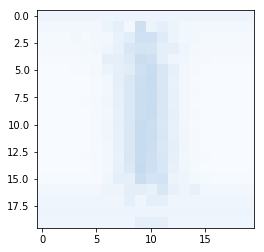

recuperando curva 16
Cantidad de tramos:  393
Largo promedio de tramos:  86.94402035623409
Mediana de largo de tramos:  93.0
Min de largo de tramos:  2
Max de largo de tramos:  149


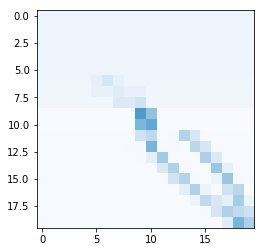

recuperando curva 17
Cantidad de tramos:  828
Largo promedio de tramos:  77.73188405797102
Mediana de largo de tramos:  74.0
Min de largo de tramos:  2
Max de largo de tramos:  149


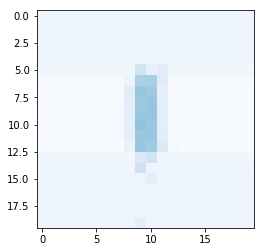

recuperando curva 18
Cantidad de tramos:  831
Largo promedio de tramos:  77.38989169675091
Mediana de largo de tramos:  73.0
Min de largo de tramos:  2
Max de largo de tramos:  149


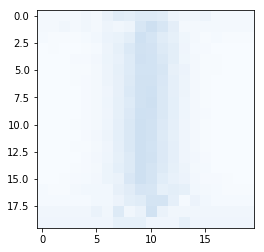

recuperando curva 19
Cantidad de tramos:  816
Largo promedio de tramos:  78.81617647058823
Mediana de largo de tramos:  76.0
Min de largo de tramos:  2
Max de largo de tramos:  149


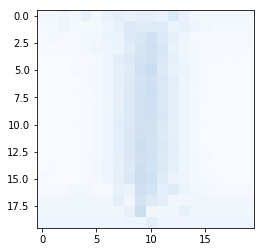

recuperando curva 20
Cantidad de tramos:  777
Largo promedio de tramos:  80.71685971685972
Mediana de largo de tramos:  80.0
Min de largo de tramos:  2
Max de largo de tramos:  149


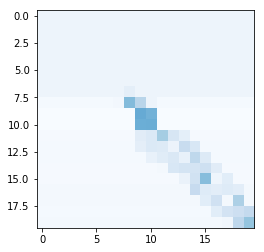

CPU times: user 1min 25s, sys: 6.16 s, total: 1min 31s
Wall time: 7.21 s


In [14]:
%%time

i=0
for lc_our_detrend in our_detrends[:20]:   
    print ("recuperando curva",i+1)
    fluxs = prepare_lc(lc_our_detrend) #divide by min
    lc_tramos =  extract_nans(fluxs) #extract nans
    
    transition_m = manual_HMM(lc_tramos, n_sta_up=10, n_sta_low=10) #si se dejan 5 arriba y 10 abajo cambia harto...

    i+=1
    plt.imshow(transition_m, cmap='Blues', vmin=0, vmax=1) #el plot se ve raro por esto..
    plt.show()

### Comportamiento Confirmados

In [16]:
confirmados=df.loc[df['NExScI Disposition']=='CONFIRMED']
index_con=list(confirmados.index)
our_detrends=our_process[index_con]
len(index_con)

2281

recuperando curva 1
Cantidad de tramos:  796
Largo promedio de tramos:  80.82663316582915
Mediana de largo de tramos:  79.0
Min de largo de tramos:  2
Max de largo de tramos:  149


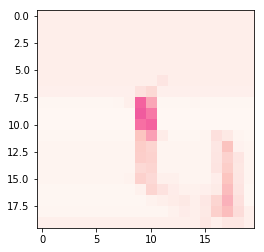

recuperando curva 2
Cantidad de tramos:  807
Largo promedio de tramos:  79.71623296158612
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


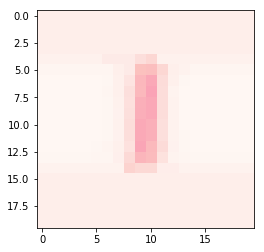

recuperando curva 3
Cantidad de tramos:  822
Largo promedio de tramos:  78.24209245742092
Mediana de largo de tramos:  76.0
Min de largo de tramos:  2
Max de largo de tramos:  146


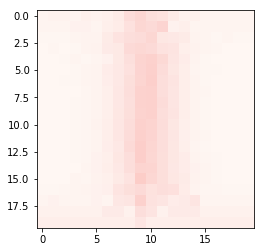

recuperando curva 4
Cantidad de tramos:  863
Largo promedio de tramos:  72.9316338354577
Mediana de largo de tramos:  66.0
Min de largo de tramos:  2
Max de largo de tramos:  146


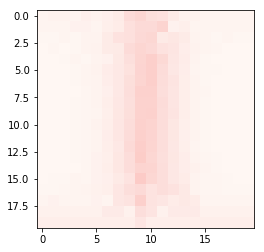

recuperando curva 5
Cantidad de tramos:  824
Largo promedio de tramos:  78.05097087378641
Mediana de largo de tramos:  74.0
Min de largo de tramos:  2
Max de largo de tramos:  149


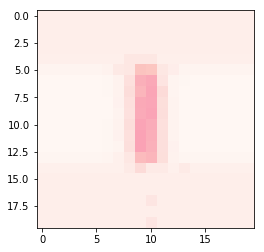

recuperando curva 6
Cantidad de tramos:  680
Largo promedio de tramos:  80.16323529411764
Mediana de largo de tramos:  79.5
Min de largo de tramos:  2
Max de largo de tramos:  146


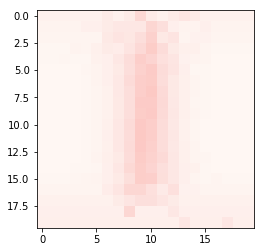

recuperando curva 7
Cantidad de tramos:  843
Largo promedio de tramos:  76.26453143534994
Mediana de largo de tramos:  71.0
Min de largo de tramos:  2
Max de largo de tramos:  149


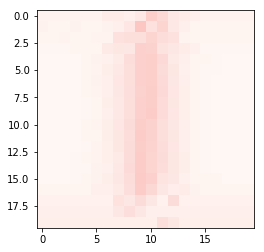

recuperando curva 8
Cantidad de tramos:  818
Largo promedio de tramos:  78.62713936430318
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


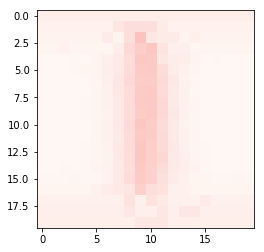

recuperando curva 9
Cantidad de tramos:  822
Largo promedio de tramos:  74.98418491484185
Mediana de largo de tramos:  69.5
Min de largo de tramos:  2
Max de largo de tramos:  149


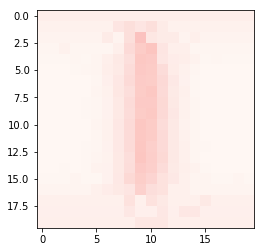

recuperando curva 10
Cantidad de tramos:  160
Largo promedio de tramos:  82.05
Mediana de largo de tramos:  88.0
Min de largo de tramos:  2
Max de largo de tramos:  145


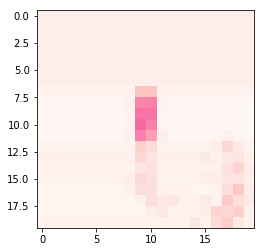

recuperando curva 11
Cantidad de tramos:  815
Largo promedio de tramos:  78.92515337423313
Mediana de largo de tramos:  76.0
Min de largo de tramos:  2
Max de largo de tramos:  149


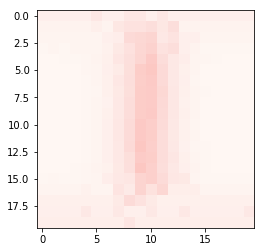

recuperando curva 12
Cantidad de tramos:  825
Largo promedio de tramos:  77.94787878787879
Mediana de largo de tramos:  76.0
Min de largo de tramos:  2
Max de largo de tramos:  149


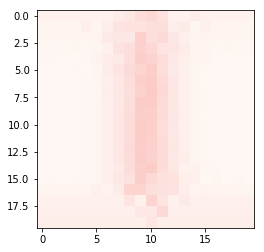

recuperando curva 13
Cantidad de tramos:  831
Largo promedio de tramos:  77.38146811070999
Mediana de largo de tramos:  74.0
Min de largo de tramos:  2
Max de largo de tramos:  149


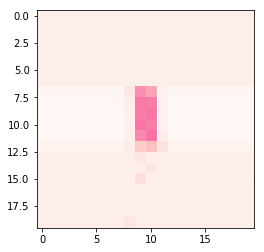

recuperando curva 14
Cantidad de tramos:  801
Largo promedio de tramos:  80.32209737827715
Mediana de largo de tramos:  80.0
Min de largo de tramos:  2
Max de largo de tramos:  149


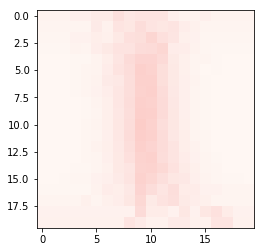

recuperando curva 15
Cantidad de tramos:  857
Largo promedio de tramos:  72.44690781796966
Mediana de largo de tramos:  62.0
Min de largo de tramos:  2
Max de largo de tramos:  149


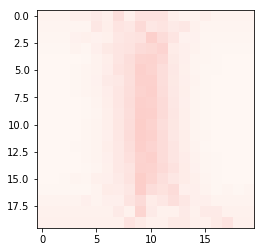

recuperando curva 16
Cantidad de tramos:  812
Largo promedio de tramos:  79.18349753694581
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


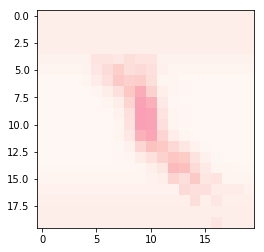

recuperando curva 17
Cantidad de tramos:  912
Largo promedio de tramos:  67.91228070175438
Mediana de largo de tramos:  58.0
Min de largo de tramos:  2
Max de largo de tramos:  146


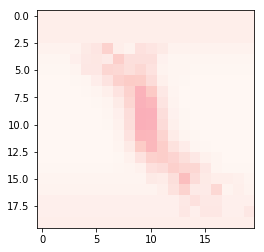

recuperando curva 18
Cantidad de tramos:  832
Largo promedio de tramos:  77.28966346153847
Mediana de largo de tramos:  75.0
Min de largo de tramos:  2
Max de largo de tramos:  149


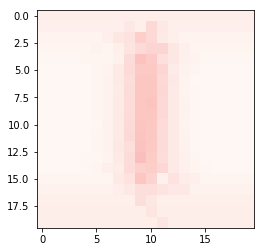

recuperando curva 19
Cantidad de tramos:  816
Largo promedio de tramos:  78.82107843137256
Mediana de largo de tramos:  78.0
Min de largo de tramos:  2
Max de largo de tramos:  149


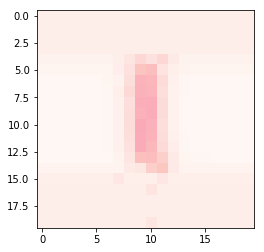

recuperando curva 20
Cantidad de tramos:  1017
Largo promedio de tramos:  57.44051130776794
Mediana de largo de tramos:  47.0
Min de largo de tramos:  2
Max de largo de tramos:  149


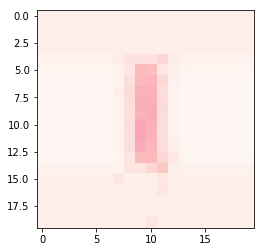

CPU times: user 1min 25s, sys: 6.16 s, total: 1min 31s
Wall time: 7.14 s


In [17]:
%%time

i=0
for lc_our_detrend in our_detrends[:20]:   
    print ("recuperando curva",i+1)
    fluxs = prepare_lc(lc_our_detrend) #divide by min
    lc_tramos =  extract_nans(fluxs) #extract nans
    
    transition_m = manual_HMM(lc_tramos, n_sta_up=10, n_sta_low=10) #si se dejan 5 arriba y 10 abajo cambia harto...

    i+=1
    plt.imshow(transition_m, cmap='RdPu', vmin=0, vmax=1) #el plot se ve raro por esto..
    plt.show()